# **Chronic Kidney Disease Classification**

----



## **Exploratory Data Analysis (EDA)**
#### There are 24 features and one target as below:

* Age(numerical) age in years
* Blood Pressure(numerical) bp in mm/Hg
* Specific Gravity(nominal) sg - (1.005,1.010,1.015,1.020,1.025)
* Albumin(nominal)al - (0,1,2,3,4,5)
* Sugar(nominal) su - (0,1,2,3,4,5)
* Red Blood Cells(nominal) rbc - (normal,abnormal)
* Pus Cell (nominal)pc - (normal,abnormal)
* Pus Cell clumps(nominal)pcc - (present,notpresent)
* Bacteria(nominal) ba - (present,notpresent)
* Blood Glucose Random(numerical) bgr in mgs/dl
* Blood Urea(numerical) bu in mgs/dl
* Serum Creatinine(numerical) sc in mgs/dl
* Sodium(numerical) sod in mEq/L
* Potassium(numerical) pot in mEq/L
* Hemoglobin(numerical) hemo in gms
* Packed Cell Volume(numerical)
* White Blood Cell Count(numerical) wc in cells/cumm
* Red Blood Cell Count(numerical) rc in millions/cmm
* Hypertension(nominal) htn - (yes,no)
* Diabetes Mellitus(nominal) dm - (yes,no)
* Coronary Artery Disease(nominal) cad - (yes,no)
* Appetite(nominal) ppet - (good,poor)
* Pedal Edema(nominal) pe - (yes,no)
* Anemia(nominal)ane - (yes,no)
> target(nominal) class - (ckd,notckd)



In [51]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [2]:
from google.colab import files
uploaded = files.upload()

Saving kidney_disease.csv to kidney_disease.csv


### **Importing and Analyzing Dataset**

In [52]:
data = pd.read_csv('kidney_disease.csv')
data.head(5)

,id,age,bp,sg,al,su,rbc,pc,pcc,ba,bgr,bu,sc,sod,pot,hemo,pcv,wc,rc,htn,dm,cad,appet,pe,ane,classification
0,0,48.0,80.0,1.020,1.0,0.0,NaN,normal,notpresent,notpresent,121.0,36.0,1.2,NaN,NaN,15.4,44,7800,5.2,yes,yes,no,good,no,no,ckd
1,1,7.0,50.0,1.020,4.0,0.0,NaN,normal,notpresent,notpresent,NaN,18.0,0.8,NaN,NaN,11.3,38,6000,NaN,no,no,no,good,no,no,ckd
2,2,62.0,80.0,1.010,2.0,3.0,normal,normal,notpresent,notpresent,423.0,53.0,1.8,NaN,NaN,9.6,31,7500,NaN,no,yes,no,poor,no,yes,ckd
3,3,48.0,70.0,1.005,4.0,0.0,normal,abnormal,present,notpresent,117.0,56.0,3.8,111.0,2.5,11.2,32,6700,3.9,yes,no,no,poor,yes,yes,ckd
4,4,51.0,80.0,1.010,2.0,0.0,normal,normal,notpresent,notpresent,106.0,26.0,1.4,NaN,NaN,11.6,35,7300,4.6,no,no,no,good,no,no,ckd


In [ ]:
display("Shape",data.shape)
display("Columns",data.columns)

'Shape'

(400, 26)

'Columns'

Index(['id', 'age', 'bp', 'sg', 'al', 'su', 'rbc', 'pc', 'pcc', 'ba', 'bgr',
       'bu', 'sc', 'sod', 'pot', 'hemo', 'pcv', 'wc', 'rc', 'htn', 'dm', 'cad',
       'appet', 'pe', 'ane', 'classification'],
      dtype='object')

In [ ]:
display(data.info())
display(data.describe().T)
display(data.dtypes)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 400 entries, 0 to 399
Data columns (total 26 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   id              400 non-null    int64  
 1   age             391 non-null    float64
 2   bp              388 non-null    float64
 3   sg              353 non-null    float64
 4   al              354 non-null    float64
 5   su              351 non-null    float64
 6   rbc             248 non-null    object 
 7   pc              335 non-null    object 
 8   pcc             396 non-null    object 
 9   ba              396 non-null    object 
 10  bgr             356 non-null    float64
 11  bu              381 non-null    float64
 12  sc              383 non-null    float64
 13  sod             313 non-null    float64
 14  pot             312 non-null    float64
 15  hemo            348 non-null    float64
 16  pcv             330 non-null    object 
 17  wc              295 non-null    obj

None

,count,mean,std,min,25%,50%,75%,max
id,400.0,199.500000,115.614301,0.000,99.75,199.50,299.25,399.000
age,391.0,51.483376,17.169714,2.000,42.00,55.00,64.50,90.000
bp,388.0,76.469072,13.683637,50.000,70.00,80.00,80.00,180.000
sg,353.0,1.017408,0.005717,1.005,1.01,1.02,1.02,1.025
al,354.0,1.016949,1.352679,0.000,0.00,0.00,2.00,5.000
su,351.0,0.450142,1.099191,0.000,0.00,0.00,0.00,5.000
bgr,356.0,148.036517,79.281714,22.000,99.00,121.00,163.00,490.000
bu,381.0,57.425722,50.503006,1.500,27.00,42.00,66.00,391.000
sc,383.0,3.072454,5.741126,0.400,0.90,1.30,2.80,76.000
sod,313.0,137.528754,10.408752,4.500,135.00,138.00,142.00,163.000


id                  int64
age               float64
bp                float64
sg                float64
al                float64
su                float64
rbc                object
pc                 object
pcc                object
ba                 object
bgr               float64
bu                float64
sc                float64
sod               float64
pot               float64
hemo              float64
pcv                object
wc                 object
rc                 object
htn                object
dm                 object
cad                object
appet              object
pe                 object
ane                object
classification     object
dtype: object

### **Data Cleaning**

In [53]:
newColumnNames={"bp":"blood_pressure","sg":"specific_gravity", "al":"albumin","su":"sugar","rbc":"red_blood_cells","pc":"pus_cell",
         "pcc":"pus_cell_clumps","ba":"bacteria","bgr":"blood_glucose_random","bu":"blood_urea","sc":"serum_creatinine",
         "sod":"sodium","pot":"potassium","hemo":"haemoglobin","pcv":"packed_cell_volume","wc":"white_blood_cell_count",
          "rc":"red_blood_cell_count","htn":"hypertension","dm":"diabetes_mellitus","cad":"coronary_artery_disease",
          "appet":"appetite","pe":"pedal_edema","ane":"anemia"}

In [54]:
# Change columns of CKD data to new columns
data.rename(columns=newColumnNames, inplace=True)

In [6]:
#check count of values for each features
data.count()

id                         400
age                        391
blood_pressure             388
specific_gravity           353
albumin                    354
sugar                      351
red_blood_cells            248
pus_cell                   335
pus_cell_clumps            396
bacteria                   396
blood_glucose_random       356
blood_urea                 381
serum_creatinine           383
sodium                     313
potassium                  312
haemoglobin                348
packed_cell_volume         330
white_blood_cell_count     295
red_blood_cell_count       270
hypertension               398
diabetes_mellitus          398
coronary_artery_disease    398
appetite                   399
pedal_edema                399
anemia                     399
classification             400
dtype: int64

In [7]:
# Drop id column 
data.drop(["id"],axis=1,inplace=True)
# Arrange data for classification 
data[['red_blood_cells','pus_cell']] = data[['red_blood_cells','pus_cell']].replace(to_replace={'abnormal':1,'normal':0})
data[['pus_cell_clumps','bacteria']] = data[['pus_cell_clumps','bacteria']].replace(to_replace={'present':1,'notpresent':0})
data[['hypertension','diabetes_mellitus','coronary_artery_disease','pedal_edema','anemia']] = data[['hypertension','diabetes_mellitus','coronary_artery_disease','pedal_edema','anemia']].replace(to_replace={'yes':1,'no':0})
data[['appetite']] = data[['appetite']].replace(to_replace={'good':1,'poor':0,'no':np.nan})
data['coronary_artery_disease'] = data['coronary_artery_disease'].replace(to_replace='\tno',value=0)
data['diabetes_mellitus'] = data['diabetes_mellitus'].replace(to_replace={'\tno':0,'\tyes':1,' yes':1, '':np.nan})
data['classification'] = data['classification'].replace(to_replace={'ckd':1.0,'ckd\t':1.0,'notckd':0.0,'no':0.0})
data['pedal_edema'] = data['pedal_edema'].replace(to_replace='good',value=0) 
data['appetite'] = data['appetite'].replace(to_replace='no',value=0)
data['coronary_artery_disease']=data['coronary_artery_disease'].replace('yes',1)

### **Checking for missing values**

In [8]:
#Check total missing values in each feature
data.isnull().sum()

age                          9
blood_pressure              12
specific_gravity            47
albumin                     46
sugar                       49
red_blood_cells            152
pus_cell                    65
pus_cell_clumps              4
bacteria                     4
blood_glucose_random        44
blood_urea                  19
serum_creatinine            17
sodium                      87
potassium                   88
haemoglobin                 52
packed_cell_volume          70
white_blood_cell_count     105
red_blood_cell_count       130
hypertension                 2
diabetes_mellitus            2
coronary_artery_disease      2
appetite                     1
pedal_edema                  1
anemia                       1
classification               0
dtype: int64

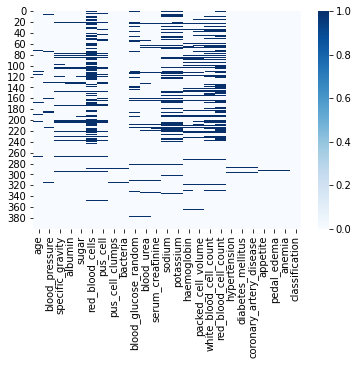

In [9]:
#visualization of null values in features
sns.heatmap(data.isnull(),cmap='Blues')

### **Handling Missing Values**

In [55]:
data['age']=data['age'].fillna(np.mean(data['age']))
data['blood_pressure']=data['blood_pressure'].fillna(np.mean(data['blood_pressure']))
data['albumin']=data['albumin'].fillna(np.mean(data['albumin']))
data['specific_gravity']=data['specific_gravity'].fillna(np.mean(data['specific_gravity']))
data['sugar']=data['sugar'].fillna(np.mean(data['sugar']))
data['blood_glucose_random']=data['blood_glucose_random'].fillna(np.mean(data['blood_glucose_random']))
data['blood_urea']=data['blood_urea'].fillna(np.mean(data['blood_urea']))
data['serum_creatinine']=data['serum_creatinine'].fillna(np.mean(data['serum_creatinine']))
data['haemoglobinhaemoglobin']=data['haemoglobin'].fillna(np.mean(data['haemoglobin']))
data['potassium']=data['potassium'].fillna(np.mean(data['potassium']))
data['sodium']=data['sodium'].fillna(np.mean(data['sodium']))
data = data.replace("\t?", np.nan)
data = data.replace(" ?", np.nan)
data = data.fillna(method='ffill')
data = data.fillna(method='backfill')

In [11]:
# Again ,Check missing values
data.isnull().sum()

age                        0
blood_pressure             0
specific_gravity           0
albumin                    0
sugar                      0
red_blood_cells            0
pus_cell                   0
pus_cell_clumps            0
bacteria                   0
blood_glucose_random       0
blood_urea                 0
serum_creatinine           0
sodium                     0
potassium                  0
haemoglobin                0
packed_cell_volume         0
white_blood_cell_count     0
red_blood_cell_count       0
hypertension               0
diabetes_mellitus          0
coronary_artery_disease    0
appetite                   0
pedal_edema                0
anemia                     0
classification             0
haemoglobinhaemoglobin     0
dtype: int64

### **Data Visualization**

In [ ]:
pip uninstall pandas_profiling

In [ ]:
pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

In [56]:
from pandas_profiling import ProfileReport
profile = ProfileReport(data, title="Kidney Disease Analysis", html={'style':{'full-width':True}})
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/40 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

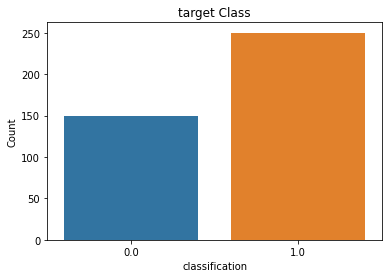

Percent of chronic kidney disease sample:  62.5 %
Percent of not a chronic kidney disease sample:  37.5 %


In [ ]:
sns.countplot(x='classification',data=data)
plt.xlabel("classification")
plt.ylabel("Count")
plt.title("target Class")
plt.show()
print('Percent of chronic kidney disease sample: ',round(len(data[data['classification']==1])/len(data['classification'])*100,2),"%")
print('Percent of not a chronic kidney disease sample: ',round(len(data[data['classification']==0])/len(data['classification'])*100,2),"%")

### **Finding Outliers**

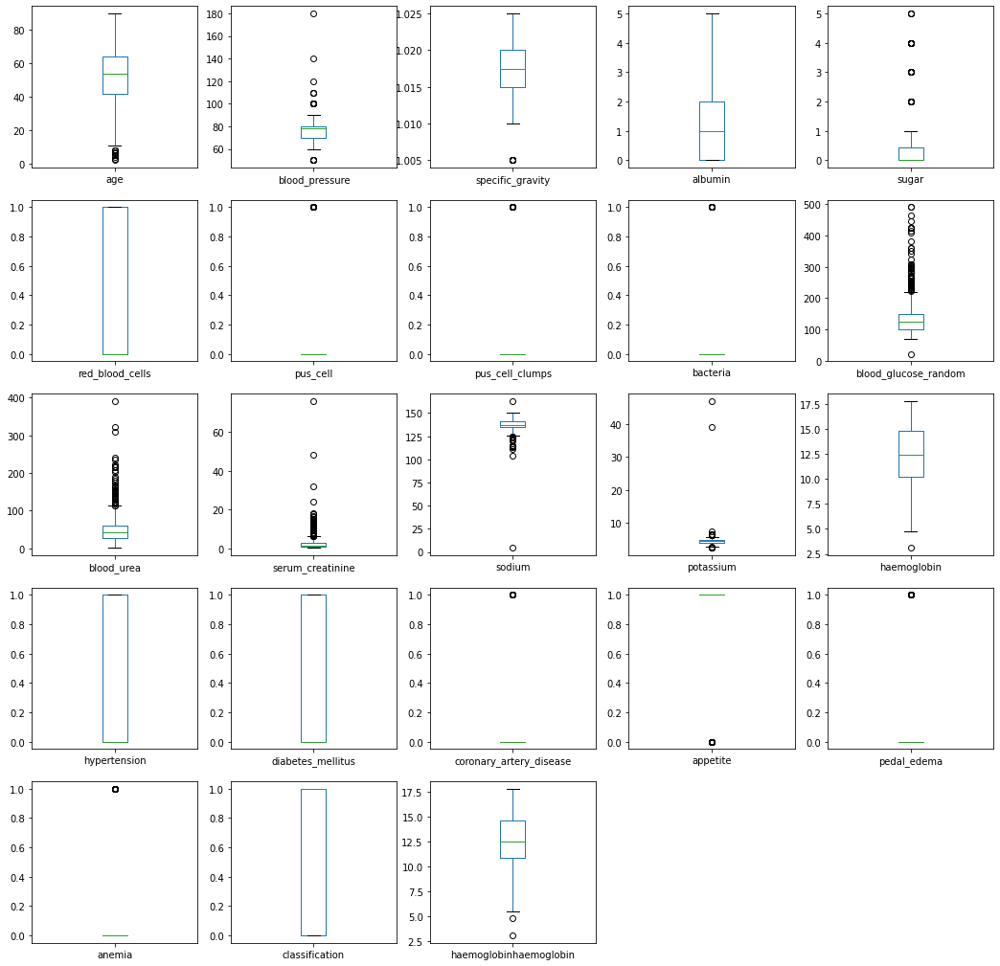

In [ ]:
data.plot(kind='box', subplots=True, layout=(5,5), sharex=False,sharey=False ,figsize =(18,18))
plt.show()

In [12]:
numericalFeatures = data.select_dtypes(include=np.number)
categoricalFeatures = data.select_dtypes(include='object')
datacorrnumerical=numericalFeatures.corr()
datacorrcategorical=categoricalFeatures.corr()

### **Pairplot to visualize the distribution**

In [ ]:
sns.pairplot(numericalFeatures)

### **Finding the correlation among attributes**

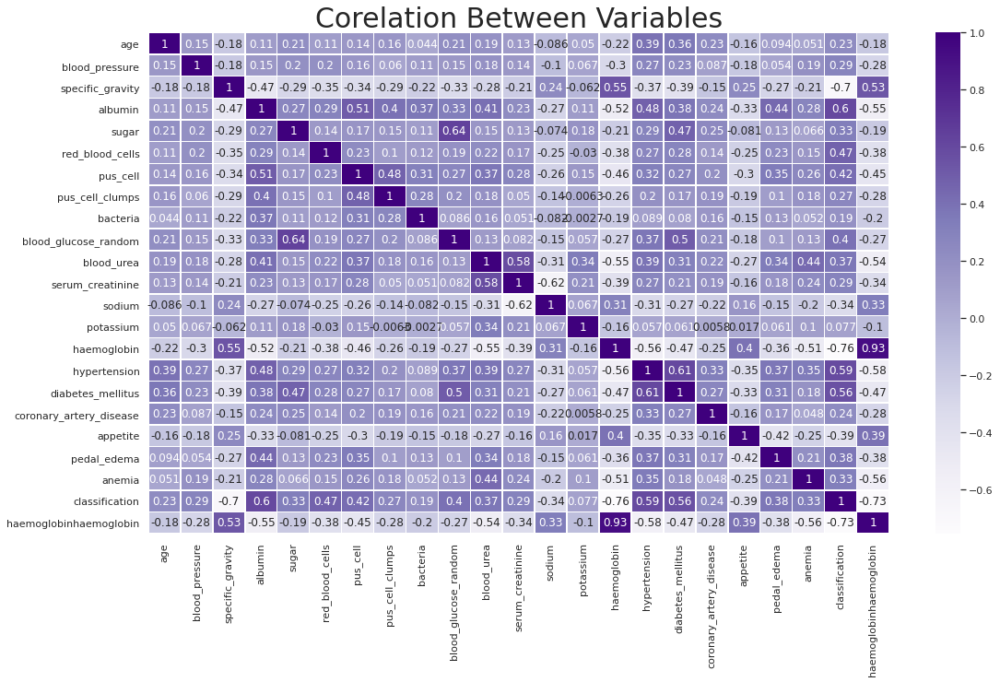

In [ ]:
sns.set(style="white") 
plt.rcParams['figure.figsize'] = (18, 10) 
sns.heatmap(datacorrnumerical, annot = True, linewidths=.5, cmap="Purples")
plt.title('Corelation Between Variables', fontsize = 30)
plt.show()

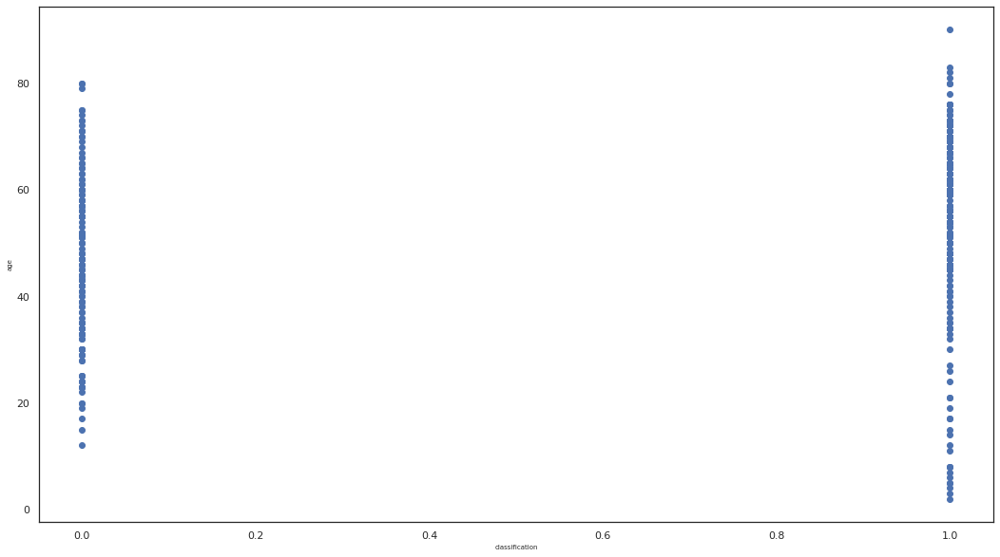

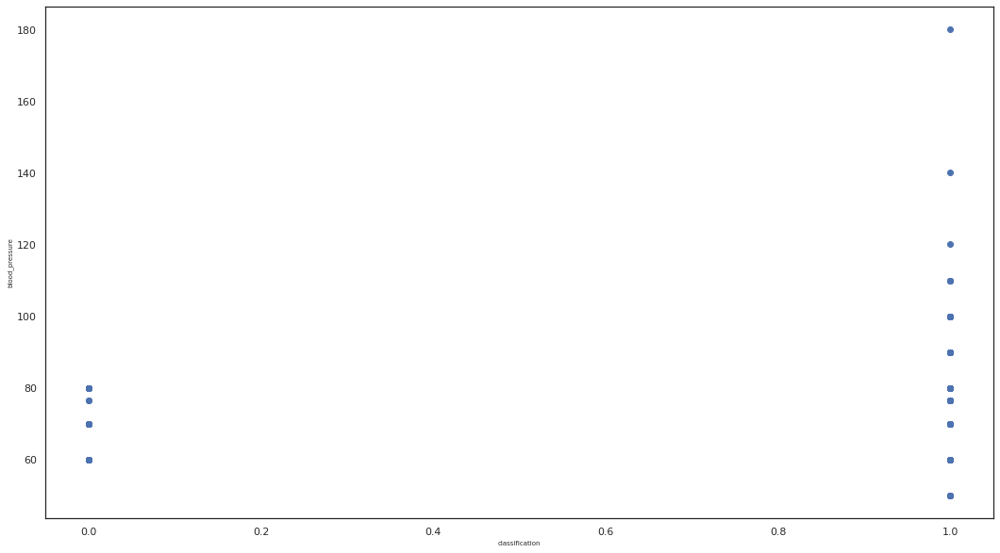

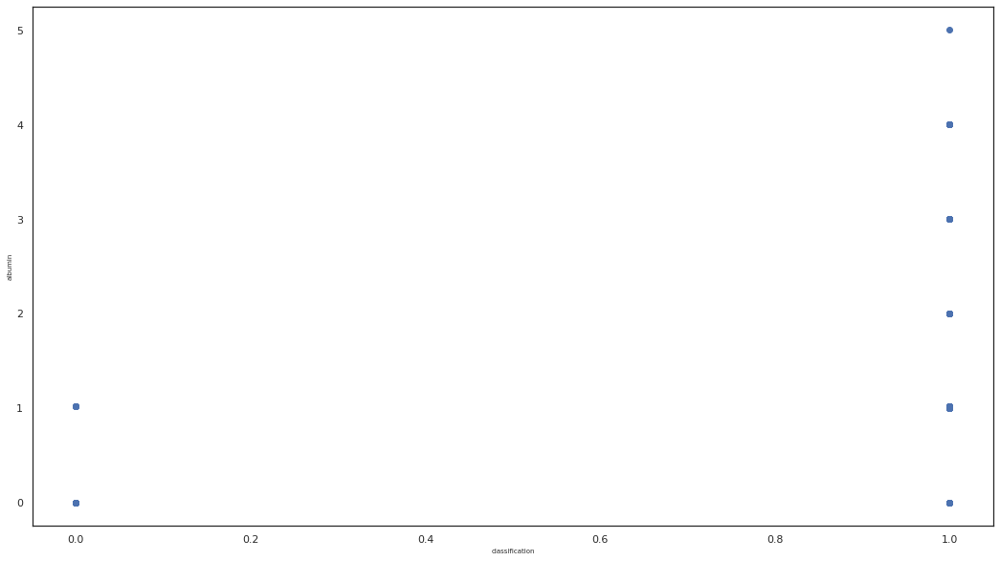

In [ ]:
plt.scatter(data['classification'],data['age'])
plt.xlabel('classification',fontsize=7)
plt.ylabel('age',fontsize=7)
plt.show()
plt.scatter(data['classification'],data['blood_pressure'])
plt.xlabel('classification',fontsize=7)
plt.ylabel('blood_pressure',fontsize=7)
plt.show()
plt.scatter(data['classification'],data['albumin'])
plt.xlabel('classification',fontsize=7)
plt.ylabel('albumin',fontsize=7)
plt.show()

### **Distribution Plot**

In [ ]:
plt.figure(figsize=(10,8))
sns.distplot(df['bgr'],color='blue')
plt.title("bgr Distribution",fontsize=16)
plt.show()
plt.figure(figsize=(10,8))
sns.distplot(df['age'],color='blue')
plt.title("Age Distribution",fontsize=16)
plt.show()
plt.figure(figsize=(10,8))
sns.distplot(df['bp'],color='blue')
plt.title("bp Distribution",fontsize=16)
plt.show()
plt.figure(figsize=(10,8))
sns.distplot(df['bu'],color='blue')
plt.title("bu Distribution",fontsize=16)
plt.show()
plt.figure(figsize=(10,8))
sns.distplot(df['hemo'],color='blue')
plt.title("hemo Distribution",fontsize=16)
plt.show()
plt.figure(figsize=(10,8))
sns.distplot(df['sc'],color='blue')
plt.title("sc Distribution",fontsize=16)
plt.show()

In [15]:
X = data.iloc[:, :-1]
y = data.iloc[:, 24]
X=X.drop('classification', axis=1)
X=pd.DataFrame(X)

### **Feature Selection**

In [13]:
from sklearn.feature_selection import RFE
from sklearn.tree import DecisionTreeClassifier

In [16]:
model = DecisionTreeClassifier()
selector = RFE(estimator=model, n_features_to_select=14)
selector.fit(X, y)

RFE(estimator=DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None,
                                     criterion='gini', max_depth=None,
                                     max_features=None, max_leaf_nodes=None,
                                     min_impurity_decrease=0.0,
                                     min_impurity_split=None,
                                     min_samples_leaf=1, min_samples_split=2,
                                     min_weight_fraction_leaf=0.0,
                                     presort='deprecated', random_state=None,
                                     splitter='best'),
    n_features_to_select=14, step=1, verbose=0)

In [17]:
selector.get_support(indices=True)
Features=X.columns
selected_features_idx = selector.get_support(indices=True)
selected_featuresDT = Features[selected_features_idx]
selected_featuresDT

Index(['specific_gravity', 'albumin', 'red_blood_cells', 'pus_cell_clumps',
       'bacteria', 'blood_glucose_random', 'haemoglobin', 'packed_cell_volume',
       'white_blood_cell_count', 'red_blood_cell_count', 'hypertension',
       'diabetes_mellitus', 'coronary_artery_disease', 'appetite'],
      dtype='object')

In [18]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import SelectFromModel
rfc = RandomForestClassifier(random_state=0, criterion='gini') 
selector = SelectFromModel(estimator=rfc)
selector.fit(X, y)

SelectFromModel(estimator=RandomForestClassifier(bootstrap=True, ccp_alpha=0.0,
                                                 class_weight=None,
                                                 criterion='gini',
                                                 max_depth=None,
                                                 max_features='auto',
                                                 max_leaf_nodes=None,
                                                 max_samples=None,
                                                 min_impurity_decrease=0.0,
                                                 min_impurity_split=None,
                                                 min_samples_leaf=1,
                                                 min_samples_split=2,
                                                 min_weight_fraction_leaf=0.0,
                                                 n_estimators=100, n_jobs=None,
                                                 oob_score=False,

In [19]:
x=X[selected_featuresDT]
x.head()

,specific_gravity,albumin,red_blood_cells,pus_cell_clumps,bacteria,blood_glucose_random,haemoglobin,packed_cell_volume,white_blood_cell_count,red_blood_cell_count,hypertension,diabetes_mellitus,coronary_artery_disease,appetite
0,1.020,1.0,0.0,0.0,0.0,121.000000,15.4,44,7800,5.2,1.0,1.0,0.0,1.0
1,1.020,4.0,0.0,0.0,0.0,148.036517,11.3,38,6000,5.2,0.0,0.0,0.0,1.0
2,1.010,2.0,0.0,0.0,0.0,423.000000,9.6,31,7500,5.2,0.0,1.0,0.0,0.0
3,1.005,4.0,0.0,1.0,0.0,117.000000,11.2,32,6700,3.9,1.0,0.0,0.0,0.0
4,1.010,2.0,0.0,0.0,0.0,106.000000,11.6,35,7300,4.6,0.0,0.0,0.0,1.0


### **Preparing the data for model**

In [20]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report

### **Splitting Data**

In [21]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.25, random_state=42)

### **Decision Tree Classifier**

In [24]:
from sklearn.tree import DecisionTreeClassifier
modeldt = DecisionTreeClassifier()
modeldt.fit(x_train, y_train)
y_preddt = modeldt.predict(x_test)

In [23]:
print(classification_report(y_test, y_preddt))

              precision    recall  f1-score   support

         0.0       0.97      1.00      0.99        35
         1.0       1.00      0.98      0.99        65

    accuracy                           0.99       100
   macro avg       0.99      0.99      0.99       100
weighted avg       0.99      0.99      0.99       100



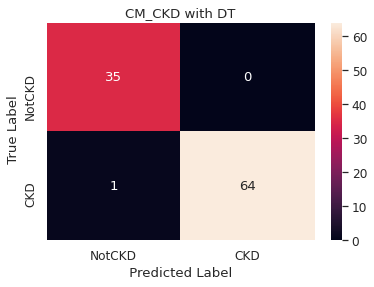

In [ ]:
CMDT=confusion_matrix(y_test,y_preddt)
sns.set(font_scale=1.1)
sns.heatmap(CMDT, annot=True,fmt="g")
ax= plt.subplot()
plt.title("CM_CKD with DT")
#plt.tight_layout()
plt.ylabel(' True Label')
plt.xlabel(' Predicted Label ')
ax.xaxis.set_ticklabels(['NotCKD', 'CKD']); ax.yaxis.set_ticklabels(['NotCKD', 'CKD']);
plt.show()

## **Exporting the tested model to a pickle file**

### **Random Forest Classifier**

In [25]:
from sklearn.ensemble import RandomForestClassifier
modelRF = RandomForestClassifier()
modelRF.fit(x_train, y_train)
RandomForestClassifier()
y_predrf = modelRF.predict(x_test)
CMRF=confusion_matrix(y_test, y_predrf)
CMRF

array([[35,  0],
       [ 0, 65]])

In [26]:
print(classification_report(y_test, y_predrf))

              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00        35
         1.0       1.00      1.00      1.00        65

    accuracy                           1.00       100
   macro avg       1.00      1.00      1.00       100
weighted avg       1.00      1.00      1.00       100



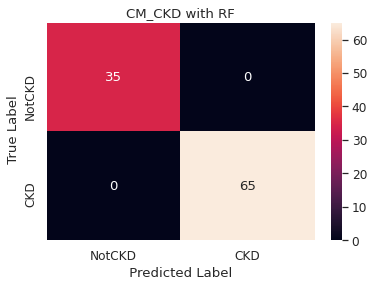

In [27]:
sns.set(font_scale=1.1)
sns.heatmap(CMRF, annot=True,fmt="g")
ax= plt.subplot()
plt.title("CM_CKD with RF")
#plt.tight_layout()
plt.ylabel(' True Label')
plt.xlabel(' Predicted Label ')
ax.xaxis.set_ticklabels(['NotCKD', 'CKD']); ax.yaxis.set_ticklabels(['NotCKD', 'CKD']);
plt.show()

### **SVM Classifier**

In [28]:
from sklearn.svm import SVC
modelsvc = SVC(C=1)
modelsvc.fit(x_train, y_train)
y_predsvc = modelsvc.predict(x_test)
CMsvm=confusion_matrix(y_test, y_predsvc)
CMsvm

array([[ 0, 35],
       [ 0, 65]])

In [29]:
print(classification_report(y_test, y_predsvc))

              precision    recall  f1-score   support

         0.0       0.00      0.00      0.00        35
         1.0       0.65      1.00      0.79        65

    accuracy                           0.65       100
   macro avg       0.33      0.50      0.39       100
weighted avg       0.42      0.65      0.51       100



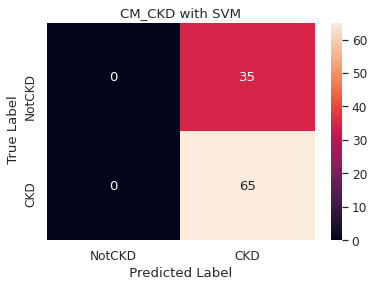

In [ ]:
sns.set(font_scale=1.1)
sns.heatmap(CMsvm, annot=True,fmt="g")
ax= plt.subplot()
plt.title("CM_CKD with SVM")
#plt.tight_layout()
plt.ylabel(' True Label')
plt.xlabel(' Predicted Label ')
ax.xaxis.set_ticklabels(['NotCKD', 'CKD']); ax.yaxis.set_ticklabels(['NotCKD', 'CKD']);
plt.show()

### **XGBoost Classifier**

In [31]:
from sklearn.neighbors import KNeighborsClassifier
modelknn = KNeighborsClassifier(n_neighbors=7)
modelknn.fit(x_train, y_train)
y_predknn = modelknn.predict(x_test)


In [ ]:
print(classification_report(y_test, y_predknn))

              precision    recall  f1-score   support

         0.0       0.54      0.71      0.62        35
         1.0       0.81      0.68      0.74        65

    accuracy                           0.69       100
   macro avg       0.68      0.70      0.68       100
weighted avg       0.72      0.69      0.70       100



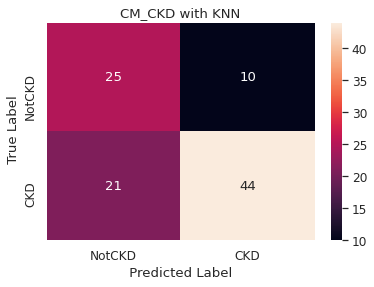

In [32]:
CMknn=confusion_matrix(y_test, y_predknn)
sns.set(font_scale=1.1)
sns.heatmap(CMknn, annot=True,fmt="g")
ax= plt.subplot()
plt.title("CM_CKD with KNN")
#plt.tight_layout()
plt.ylabel(' True Label')
plt.xlabel(' Predicted Label ')
ax.xaxis.set_ticklabels(['NotCKD', 'CKD']); ax.yaxis.set_ticklabels(['NotCKD', 'CKD']);
plt.show()

In [35]:
from sklearn.model_selection import GridSearchCV
#create param
model_param = {
    'DecisionTreeClassifier':{
        'model':DecisionTreeClassifier(),
        'param':{
            'criterion': ['gini','entropy']
        }
    },
        'RandomForestClassifier':{
        'model':RandomForestClassifier(),
        'param':{
            'n_estimators': [20,50,80,120,150]
        }
    },
        'KNeighborsClassifier':{
        'model':KNeighborsClassifier(),
        'param':{
            'n_neighbors': [5,10,15,20,25]
        }
    },
        'SVC':{
        'model':SVC(),
        'param':{
            'kernel':['rbf','linear','sigmoid']
         
        }},
        
    }

In [36]:
scores =[]
for model_name, mp in model_param.items():
    model_selection = GridSearchCV(estimator=mp['model'],param_grid=mp['param'],cv=5,return_train_score=False)
    model_selection.fit(x,y)
    scores.append({
        'Model': model_name,
        'Best Score': model_selection.best_score_,
        'Best Parameters': model_selection.best_params_
    })

In [37]:
df_model_score = pd.DataFrame(scores,columns=['Model','Best Score','Best Parameters'])
df_model_score

,Model,Best Score,Best Parameters
0,DecisionTreeClassifier,0.9775,{'criterion': 'entropy'}
1,RandomForestClassifier,1.0000,{'n_estimators': 120}
2,KNeighborsClassifier,0.6350,{'n_neighbors': 5}
3,SVC,0.9725,{'kernel': 'linear'}


In [38]:
model_rfc = RandomForestClassifier(n_estimators = 120)
model_rfc.fit(x_train, y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=120,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [41]:
y_pred = model_rfc.predict(x_test)
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00        35
         1.0       1.00      1.00      1.00        65

    accuracy                           1.00       100
   macro avg       1.00      1.00      1.00       100
weighted avg       1.00      1.00      1.00       100



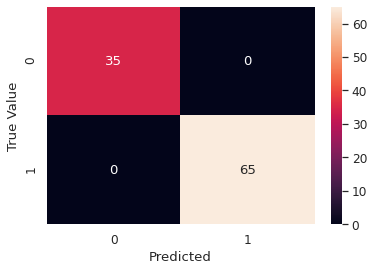

In [43]:
#Confusion Matrix
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test,model_rfc.predict(x_test))
#plot the graph
from matplotlib import pyplot as plt
import seaborn as sn
sn.heatmap(cm, annot=True)
plt.xlabel('Predicted')
plt.ylabel('True Value')
plt.show()

## **Exporting the tested model to a pickle file**



> Testing single value



In [45]:
x_test.head()

,specific_gravity,albumin,red_blood_cells,pus_cell_clumps,bacteria,blood_glucose_random,haemoglobin,packed_cell_volume,white_blood_cell_count,red_blood_cell_count,hypertension,diabetes_mellitus,coronary_artery_disease,appetite
209,1.020000,0.000000,0.0,0.0,0.0,148.036517,11.5,41,6900,4.9,0.0,0.0,0.0,1.0
280,1.017408,1.016949,0.0,0.0,0.0,93.000000,13.3,52,8100,5.2,0.0,0.0,0.0,1.0
33,1.020000,2.000000,1.0,0.0,0.0,140.000000,10.1,29,9600,4.0,1.0,0.0,0.0,0.0
210,1.015000,4.000000,0.0,0.0,0.0,255.000000,7.3,20,9800,3.9,1.0,1.0,1.0,1.0
93,1.010000,3.000000,1.0,1.0,0.0,295.000000,9.2,30,7000,3.2,1.0,1.0,1.0,0.0


In [46]:
model_rfc.predict(np.array([1.020000,0.000000,0.0,0.0,0.0,148.036517,11.5,41,6900,4.9,0.0,0.0,0.0,1.0]).reshape(1,-1))[0]

1.0

In [44]:
import pickle
with open('kidney_model.pickle','wb') as f:
    pickle.dump(model_rfc,f)